## AI6128 - URBAN COMPUTING PROJECT 1 (Group 7)

MEMBERS : 
(1) Ming Yuan Kee,
(2) Sathananthar Suresh, 
(3) Sui Jinhong,
(4) Robert George Susanto

### Instructions/Note
**1** Ensure this Script, compute_f.py, io_f.py and visualize_f_matplotlib.py and /data folder are all in the same directory

**2** Visualization is using Matplotlib and mpld3.

**3** An output folder is created and stores all the HTML files. 

In [1]:
#Install any libraries you do not have
#!pip install matplotlib
#!pip install mpld3

### Import the required modules

In [2]:
import json
import os
from pathlib import Path
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
import mpld3
import random
import torch

#Import the modules that contain custom functions
#ensure all the .py files are in the same directory as the this notebook
from compute_f import split_ts_seq, compute_step_positions
from io_f import read_data_file
from visualize_f_matplotlib import visualize_trajectory, visualize_heatmap, save_figure_to_html, visualize_trajectory_step_position

In [3]:
# Set the seed for reproducibility
def set_seed(seed=0):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)  # If you are using multi-GPU.
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

# Call the function to set the seed
set_seed(0)

In [4]:
#Change 'site1' or 'site2' and their respective floor number. 
#below is an example of site1 and floor F1

#data folder should be in the same directory as this notebook
#data folder contains the samples of the site1 and site2

floor_data_dir = './data/site1/F1'
path_data_dir = floor_data_dir + '/path_data_files'
floor_plan_filename = floor_data_dir + '/floor_image.png'
floor_info_filename = floor_data_dir + '/floor_info.json'

#saving of output images and html files
save_dir = './output/matplotlib/site1/F1'
path_image_save_dir = save_dir + '/path_images'
step_position_image_save_dir = save_dir
magn_image_save_dir = save_dir
wifi_image_save_dir = save_dir + '/wifi_images'
ibeacon_image_save_dir = save_dir + '/ibeacon_images'
wifi_count_image_save_dir = save_dir

### This function is to align and calibrate magnetic, Wi-Fi, and iBeacon data with step positions from multiple files, and return the combined data for each position, while displaying the progress of processing. It is also used to process accelerometer, gyro and rotation 

In [5]:
def calibrate_magnetic_wifi_ibeacon_to_position(path_file_list):

    mwi_datas = {}
    with tqdm(total=len(path_file_list), desc="Processing Files", unit="file") as pbar:
        for path_filename in path_file_list:
            # Read sensor data from each file
            path_datas = read_data_file(path_filename)
            acce_datas = path_datas.acce
            magn_datas = path_datas.magn
            ahrs_datas = path_datas.ahrs
            wifi_datas = path_datas.wifi
            ibeacon_datas = path_datas.ibeacon
            gyro_datas = path_datas.gyro
            posi_datas = path_datas.waypoint

            # Compute step positions
            step_positions = compute_step_positions(acce_datas, ahrs_datas, posi_datas)

           # Process Wi-Fi data
            if wifi_datas.size != 0:
                sep_tss = np.unique(wifi_datas[:, 0].astype(float))
                wifi_datas_list = split_ts_seq(wifi_datas, sep_tss)
                for wifi_ds in wifi_datas_list:
                    diff = np.abs(step_positions[:, 0] - float(wifi_ds[0, 0]))
                    index = np.argmin(diff)
                    target_xy_key = tuple(step_positions[index, 1:3])
                    if target_xy_key in mwi_datas:
                        mwi_datas[target_xy_key]['wifi'] = np.append(mwi_datas[target_xy_key]['wifi'], wifi_ds, axis=0)
                    else:
                        mwi_datas[target_xy_key] = {
                            'magnetic': np.zeros((0, 4)),
                            'wifi': wifi_ds,
                            'ibeacon': np.zeros((0, 3)),
                            'acce': np.zeros((0, 4)),
                            'gyro': np.zeros((0, 4)),
                            'ahrs': np.zeros((0, 4))  # AHRS placeholder added
                        }

            # Process iBeacon data
            if ibeacon_datas.size != 0:
                sep_tss = np.unique(ibeacon_datas[:, 0].astype(float))
                ibeacon_datas_list = split_ts_seq(ibeacon_datas, sep_tss)
                for ibeacon_ds in ibeacon_datas_list:
                    diff = np.abs(step_positions[:, 0] - float(ibeacon_ds[0, 0]))
                    index = np.argmin(diff)
                    target_xy_key = tuple(step_positions[index, 1:3])
                    if target_xy_key in mwi_datas:
                        mwi_datas[target_xy_key]['ibeacon'] = np.append(mwi_datas[target_xy_key]['ibeacon'], ibeacon_ds, axis=0)
                    else:
                        mwi_datas[target_xy_key] = {
                            'magnetic': np.zeros((0, 4)),
                            'wifi': np.zeros((0, 5)),
                            'ibeacon': ibeacon_ds,
                            'acce': np.zeros((0, 4)),
                            'gyro': np.zeros((0, 4)),
                            'ahrs': np.zeros((0, 4))  # AHRS placeholder added
                        }

            # Process magnetic data
            sep_tss = np.unique(magn_datas[:, 0].astype(float))
            magn_datas_list = split_ts_seq(magn_datas, sep_tss)
            for magn_ds in magn_datas_list:
                diff = np.abs(step_positions[:, 0] - float(magn_ds[0, 0]))
                index = np.argmin(diff)
                target_xy_key = tuple(step_positions[index, 1:3])
                if target_xy_key in mwi_datas:
                    mwi_datas[target_xy_key]['magnetic'] = np.append(mwi_datas[target_xy_key]['magnetic'], magn_ds, axis=0)
                else:
                    mwi_datas[target_xy_key] = {
                        'magnetic': magn_ds,
                        'wifi': np.zeros((0, 5)),
                        'ibeacon': np.zeros((0, 3)),
                        'acce': np.zeros((0, 4)),
                        'gyro': np.zeros((0, 4)),
                        'ahrs': np.zeros((0, 4))  # AHRS placeholder added
                    }

            # Process accelerometer data
            sep_tss = np.unique(acce_datas[:, 0].astype(float))
            acce_datas_list = split_ts_seq(acce_datas, sep_tss)
            for acce_ds in acce_datas_list:
                diff = np.abs(step_positions[:, 0] - float(acce_ds[0, 0]))
                index = np.argmin(diff)
                target_xy_key = tuple(step_positions[index, 1:3])
                if target_xy_key in mwi_datas:
                    mwi_datas[target_xy_key]['acce'] = np.append(mwi_datas[target_xy_key]['acce'], acce_ds, axis=0)
                else:
                    mwi_datas[target_xy_key] = {
                        'magnetic': np.zeros((0, 4)),
                        'wifi': np.zeros((0, 5)),
                        'ibeacon': np.zeros((0, 3)),
                        'acce': acce_ds,
                        'gyro': np.zeros((0, 4)),
                        'ahrs': np.zeros((0, 4))  # AHRS placeholder added
                    }

            # Process gyro data
            sep_tss = np.unique(gyro_datas[:, 0].astype(float))
            gyro_datas_list = split_ts_seq(gyro_datas, sep_tss)
            for gyro_ds in gyro_datas_list:
                diff = np.abs(step_positions[:, 0] - float(gyro_ds[0, 0]))
                index = np.argmin(diff)
                target_xy_key = tuple(step_positions[index, 1:3])
                if target_xy_key in mwi_datas:
                    mwi_datas[target_xy_key]['gyro'] = np.append(mwi_datas[target_xy_key]['gyro'], gyro_ds, axis=0)
                else:
                    mwi_datas[target_xy_key] = {
                        'magnetic': np.zeros((0, 4)),
                        'wifi': np.zeros((0, 5)),
                        'ibeacon': np.zeros((0, 3)),
                        'acce': np.zeros((0, 4)),
                        'gyro': gyro_ds,
                        'ahrs': np.zeros((0, 4))  # AHRS placeholder added
                    }

            # Process AHRS data
            sep_tss = np.unique(ahrs_datas[:, 0].astype(float))
            ahrs_datas_list = split_ts_seq(ahrs_datas, sep_tss)
            for ahrs_ds in ahrs_datas_list:
                diff = np.abs(step_positions[:, 0] - float(ahrs_ds[0, 0]))
                index = np.argmin(diff)
                target_xy_key = tuple(step_positions[index, 1:3])
                if target_xy_key in mwi_datas:
                    mwi_datas[target_xy_key]['ahrs'] = np.append(mwi_datas[target_xy_key]['ahrs'], ahrs_ds, axis=0)
                else:
                    mwi_datas[target_xy_key] = {
                        'magnetic': np.zeros((0, 4)),
                        'wifi': np.zeros((0, 5)),
                        'ibeacon': np.zeros((0, 3)),
                        'acce': np.zeros((0, 4)),
                        'gyro': np.zeros((0, 4)),
                        'ahrs': ahrs_ds  # Actual AHRS data
                    }

            # Update the progress bar after processing each file
            pbar.update(1)

    print('Completed.....')
    return mwi_datas

### Each function processes the corresponding data (magnetic, Wi-Fi, iBeacon) from the combined data structure (mwi_datas) and extracts specific information for further analysis

In [6]:
def extract_magnetic_strength(mwi_datas):
    magnetic_strength = {}
    for position_key in mwi_datas:
        # print(f'Position: {position_key}')

        magnetic_data = mwi_datas[position_key]['magnetic']
        magnetic_s = np.mean(np.sqrt(np.sum(magnetic_data[:, 1:4] ** 2, axis=1)))
        magnetic_strength[position_key] = magnetic_s

    return magnetic_strength

def extract_wifi_rssi(mwi_datas):
    wifi_rssi = {}
    for position_key in mwi_datas:
        # print(f'Position: {position_key}')

        wifi_data = mwi_datas[position_key]['wifi']
        for wifi_d in wifi_data:
            bssid = wifi_d[2]
            rssi = int(wifi_d[3])

            if bssid in wifi_rssi:
                position_rssi = wifi_rssi[bssid]
                if position_key in position_rssi:
                    old_rssi = position_rssi[position_key][0]
                    old_count = position_rssi[position_key][1]
                    position_rssi[position_key][0] = (old_rssi * old_count + rssi) / (old_count + 1)
                    position_rssi[position_key][1] = old_count + 1
                else:
                    position_rssi[position_key] = np.array([rssi, 1])
            else:
                position_rssi = {}
                position_rssi[position_key] = np.array([rssi, 1])

            wifi_rssi[bssid] = position_rssi

    return wifi_rssi

def extract_ibeacon_rssi(mwi_datas):
    ibeacon_rssi = {}
    for position_key in mwi_datas:
        # print(f'Position: {position_key}')

        ibeacon_data = mwi_datas[position_key]['ibeacon']
        for ibeacon_d in ibeacon_data:
            ummid = ibeacon_d[1]
            rssi = int(ibeacon_d[2])

            if ummid in ibeacon_rssi:
                position_rssi = ibeacon_rssi[ummid]
                if position_key in position_rssi:
                    old_rssi = position_rssi[position_key][0]
                    old_count = position_rssi[position_key][1]
                    position_rssi[position_key][0] = (old_rssi * old_count + rssi) / (old_count + 1)
                    position_rssi[position_key][1] = old_count + 1
                else:
                    position_rssi[position_key] = np.array([rssi, 1])
            else:
                position_rssi = {}
                position_rssi[position_key] = np.array([rssi, 1])

            ibeacon_rssi[ummid] = position_rssi

    return ibeacon_rssi
# 
def extract_wifi_count(mwi_datas):
    wifi_counts = {}
    for position_key in mwi_datas:
        # print(f'Position: {position_key}')

        wifi_data = mwi_datas[position_key]['wifi']
        count = np.unique(wifi_data[:, 2]).shape[0]
        wifi_counts[position_key] = count

    return wifi_counts


### This code creates necessary directories for saving images and loads floor information (such as width and height) from a JSON file. It then retrieves the list of path data files from a specified directory.

In [7]:
Path(path_image_save_dir).mkdir(parents=True, exist_ok=True)
Path(magn_image_save_dir).mkdir(parents=True, exist_ok=True)
Path(wifi_image_save_dir).mkdir(parents=True, exist_ok=True)
Path(ibeacon_image_save_dir).mkdir(parents=True, exist_ok=True)

with open(floor_info_filename) as f:
    floor_info = json.load(f)
width_meter = floor_info["map_info"]["width"]
height_meter = floor_info["map_info"]["height"]

path_filenames = list(Path(path_data_dir).resolve().glob("*.txt"))

### To visualize ground truth positions from path data files while displaying a progress bar and ensuring that site-floor combinations are processed only once.

In [8]:
from tqdm import tqdm

# Set to keep track of unique site and floor combinations
unique_site_floor = set()

# Progress bar for processing files
print('Visualizing ground truth positions...')

with tqdm(total=len(path_filenames), desc="Processing Files", unit="file") as pbar:
    for path_filename in path_filenames:
        # Extract site and floor from the file path
        parts = str(path_filename).split("/")
        site = parts[-4]  # Extract 'site1' from the path
        floor = parts[-3]  # Extract 'F1' from the path
        
        # Check if this site-floor combination is unique
        site_floor = (site, floor)
        if site_floor not in unique_site_floor:
            tqdm.write(f'Processing site: {site}, floor: {floor}...')
            unique_site_floor.add(site_floor)

        # Process the file (same as before)
        path_data = read_data_file(path_filename)
        path_id = f"Site({site})_Floor({floor})_Path_name({path_filename.name.split('.')[0]})"        
        fig = visualize_trajectory(path_data.waypoint[:, 1:3], floor_plan_filename, width_meter, height_meter, title=path_id, show=False)
        
        # Save the output Png
        html_filename = f'{path_image_save_dir}/{path_id}.html'
        html_filename = str(Path(html_filename).resolve())
        save_figure_to_html(fig, html_filename)

        # Update the progress bar
        pbar.update(1)

print('Completed.....')

Visualizing ground truth positions...


Processing Files:   0%|          | 0/120 [00:00<?, ?file/s]

Processing site: site1, floor: F1...


Processing Files: 100%|██████████| 120/120 [00:46<00:00,  2.59file/s]

Completed.....


### This code calibrates and visualizes the step positions along with magnetic, Wi-Fi, and iBeacon data using the provided path filenames.

In [9]:
# 2. visualize step position, magnetic, wifi, ibeacon
print('Calibration of magnetic_wifi_ibeacon_to_position.')
mwi_datas = calibrate_magnetic_wifi_ibeacon_to_position(path_filenames)

Calibration of magnetic_wifi_ibeacon_to_position.


Processing Files: 100%|██████████| 120/120 [00:53<00:00,  2.24file/s]

Completed.....


### This code block is to visualize the computed step positions from mwi_datas and save the visualization as an HTML file.

In [10]:
import importlib
import visualize_f_matplotlib

# Reload the module
importlib.reload(visualize_f_matplotlib)

# Re-import the updated functions
from visualize_f_matplotlib import visualize_trajectory, visualize_heatmap, save_figure_to_html, visualize_trajectory_step_position

step_positions = np.array(list(mwi_datas.keys()))
fig = visualize_trajectory_step_position(step_positions, floor_plan_filename, width_meter, height_meter, mode='o',title=f'Site({site})_Floor({floor})_Step Position', show=True)
html_filename = f'{step_position_image_save_dir}/Site({site})_Floor({floor})_step_positions.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

### This code extracts magnetic field strength from mwi_datas, creates a heatmap visualization of the magnetic strength over the positions, and saves the visualization as an HTML file.

In [11]:
magnetic_strength = extract_magnetic_strength(mwi_datas)
heat_positions = np.array(list(magnetic_strength.keys()))
heat_values = np.array(list(magnetic_strength.values()))
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='microtesla (µT)', title=f'Site:{site}_Floor:{floor}_Magnetic Strength', show=True)
html_filename = f'{magn_image_save_dir}/magnetic_strength.png'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Save the plot as PNG
plt.savefig('MagneticStrength Heatmap.png', format='png', dpi=300, bbox_inches='tight')

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

<Figure size 640x480 with 0 Axes>

### This codes determining Key WIFI RSSI Parameters. It also extracts Wi-Fi RSSI values for a specific access point (AP) from mwi_datas, generates a heatmap showing the RSSI strength across the positions, and saves the visualization as an HTML file.

In [12]:
def calculate_manhattan_distance(data):
    """
    Calculate the Manhattan distance between the coordinates of the device with the highest and lowest RSS

    """
    max_val_point = max(data, key=lambda k: data[k][0])
    min_val_point = min(data, key=lambda k: data[k][0]) 
    
    # Extract coordinates from position keys
    x1, y1 = max_val_point
    x2, y2 = min_val_point

    # Calculate the Manhattan distance
    distance = abs(x2 - x1) + abs(y2 - y1)
    
    return distance

def sum_rss(data):
    total_sum = 0  
    for key, value in data.items():
        total_sum += value[0]  # Add the first element of the array to the total sum
    return total_sum

In [13]:
wifi_rssi = extract_wifi_rssi(mwi_datas)
print(f'This floor has {len(wifi_rssi.keys())} wifi aps')

# Count coverage of each wifi APs
wifi_aps_dict = {}
for wifi_ap in list(wifi_rssi.keys()):
    device_count = len(wifi_rssi[wifi_ap].values())
    # Calculates manhattan distance between strongest and weakest RSS
    max_dist = calculate_manhattan_distance(wifi_rssi[wifi_ap])
    sum_rss_val = sum_rss(wifi_rssi[wifi_ap])
    wifi_aps_dict[wifi_ap] = [device_count, max_dist, sum_rss_val]

wifis_df = pd.DataFrame.from_dict(wifi_aps_dict, orient='index', columns=['counts', 'max_distance', 'sum_rss'])
wifis_df = wifis_df.reset_index().rename(columns={'index': 'wifi'})

# many wifi might have the same number of devices. take the first occurrence
wifi_max_count  = wifis_df.loc[wifis_df.counts == wifis_df.counts.max()]['wifi'][:1].item()

min_val = wifis_df.loc[wifis_df.counts>20].counts.min()
wifi_min_count  = wifis_df.loc[wifis_df.counts == min_val]['wifi'][:1].item()

# median might have many wifi. take the first occurrence
median_val = round(wifis_df.counts.median(),0)
wifi_median_count = wifis_df.loc[wifis_df.counts == median_val]['wifi'][:1].item()

# Higher devices connected might not equate to higher coverage. Sort by max manhattan distance instead
count_threshold = 500
data_df = wifis_df.loc[(wifis_df.counts >= count_threshold)]
max_distance_val =  data_df.max_distance.max()
wifi_max_distance = data_df.loc[(data_df.max_distance == max_distance_val) ]['wifi'][:1].item()

# Minimum RSS
lowest_rss_val = wifis_df.sum_rss.min()

wifi_rss = wifis_df.loc[wifis_df.sum_rss == lowest_rss_val]['wifi'][:1].item()

print(f'Max: {wifis_df.counts.max()}')
print(f'Min: {min_val}')
print(f'Median: {median_val}')
print(f'Max distance: {max_distance_val}')
print(f'Min RSS: {lowest_rss_val}')
# print(f'RSS: {sec_lowest_rss_val}')

This floor has 2524 wifi aps
Max: 1562
Min: 21
Median: 178.0
Max distance: 168.81806546457153
Min RSS: -117723


In [14]:
#Highest Distance
target_wifi = wifi_max_distance
heat_positions = np.array(list(wifi_rssi[target_wifi].keys()))
heat_values = np.array(list(wifi_rssi[target_wifi].values()))[:, 0]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='dBm', title=f'Site:{site}_Floor:{floor}_Wifi: {target_wifi} RSSI', show=True)
html_filename = f'{wifi_image_save_dir}/{target_wifi.replace(":", "-")}.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)
# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

In [15]:
#Lowest Total RSS
target_wifi = wifi_rss
heat_positions = np.array(list(wifi_rssi[target_wifi].keys()))
heat_values = np.array(list(wifi_rssi[target_wifi].values()))[:, 0]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='dBm', title=f'Site:{site}_Floor:{floor}_Wifi: {target_wifi} RSSI', show=True)
html_filename = f'{wifi_image_save_dir}/{target_wifi.replace(":", "-")}.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)
# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

In [16]:
#Max Coverage
target_wifi = wifi_max_count
heat_positions = np.array(list(wifi_rssi[target_wifi].keys()))
heat_values = np.array(list(wifi_rssi[target_wifi].values()))[:, 0]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='dBm', title=f'Site:{site}_Floor:{floor}_Wifi: {target_wifi} RSSI', show=True)
html_filename = f'{wifi_image_save_dir}/{target_wifi.replace(":", "-")}.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)
# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

### This code extracts Wi-Fi access point counts from mwi_datas, filters out positions with no Wi-Fi detections, generates a heatmap visualizing the number of detected Wi-Fi access points across various positions, and saves the resulting visualization as an HTML file.

In [17]:
wifi_counts = extract_wifi_count(mwi_datas)
heat_positions = np.array(list(wifi_counts.keys()))
heat_values = np.array(list(wifi_counts.values()))
# filter out positions that no wifi detected
mask = heat_values != 0
heat_positions = heat_positions[mask]
heat_values = heat_values[mask]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='number', title=f'Site:{site} Floor:{floor} Wifi Count', show=True)
html_filename = f'{wifi_count_image_save_dir}/wifi_count.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)


### This code extracts iBeacon RSSI values for a specific iBeacon from mwi_datas, prompts the user to input the target iBeacon UUID, generates a heatmap displaying the RSSI strength across various positions, and saves the visualization as an HTML file.

In [18]:
ibeacon_rssi = extract_ibeacon_rssi(mwi_datas)
print(f'This floor has {len(ibeacon_rssi.keys())} ibeacons')
# ten_ibeacon_ummids = list(ibeacon_rssi.keys())[0:10]
# print('Example 10 ibeacon UUID_MajorID_MinorIDs:\n')
# for ummid in ten_ibeacon_ummids:
#     print(ummid)
# target_ibeacon = input(f"Please input target ibeacon UUID_MajorID_MinorID:\n")

This floor has 20 ibeacons


In [19]:
target_ibeacon = '9195B3AD-A9D0-4500-85FF-9FB0F65A5201_0_0'
heat_positions = np.array(list(ibeacon_rssi[target_ibeacon].keys()))
heat_values = np.array(list(ibeacon_rssi[target_ibeacon].values()))[:, 0]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='dBm', title=f'Site:{site}_Floor:{floor}_iBeacon: {target_ibeacon} RSSI', show=True)
html_filename = f'{ibeacon_image_save_dir}/{target_ibeacon}.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

In [20]:
target_ibeacon = '6B76E28A-6FA2-48C9-8502-C1DAA388AB2C_47237_15305'
heat_positions = np.array(list(ibeacon_rssi[target_ibeacon].keys()))
heat_values = np.array(list(ibeacon_rssi[target_ibeacon].values()))[:, 0]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='dBm', title=f'Site:{site}_Floor:{floor}_iBeacon: {target_ibeacon} RSSI', show=True)
html_filename = f'{ibeacon_image_save_dir}/{target_ibeacon}.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

In [21]:
target_ibeacon = 'E7FC9D3C-EF01-4B70-B280-2CF6D50FA5CA_13394_63898'
heat_positions = np.array(list(ibeacon_rssi[target_ibeacon].keys()))
heat_values = np.array(list(ibeacon_rssi[target_ibeacon].values()))[:, 0]
fig = visualize_heatmap(heat_positions, heat_values, floor_plan_filename, width_meter, height_meter, colorbar_title='dBm', title=f'Site:{site}_Floor:{floor}_iBeacon: {target_ibeacon} RSSI', show=True)
html_filename = f'{ibeacon_image_save_dir}/{target_ibeacon}.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)

In [22]:
# Extract iBeacon RSSI for all iBeacons
ibeacon_rssi = extract_ibeacon_rssi(mwi_datas)
print(f'This floor has {len(ibeacon_rssi.keys())} iBeacons')

# Combine the heat positions and values for all iBeacons
all_heat_positions = []
all_heat_values = []

for ummid in ibeacon_rssi.keys():
    heat_positions = np.array(list(ibeacon_rssi[ummid].keys()))
    heat_values = np.array(list(ibeacon_rssi[ummid].values()))[:, 0]
    
    # Append to the combined lists
    all_heat_positions.append(heat_positions)
    all_heat_values.append(heat_values)

# Convert combined lists to numpy arrays
all_heat_positions = np.concatenate(all_heat_positions)
all_heat_values = np.concatenate(all_heat_values)

# Plot all iBeacon points on a single map
fig = visualize_heatmap(all_heat_positions, all_heat_values, floor_plan_filename, 
                        width_meter, height_meter, colorbar_title='dBm', 
                        title=f'Site:{site}_Floor:{floor}_{len(ibeacon_rssi.keys())}iBeacons RSSI', show=True)

# Save the figure
html_filename = f'{ibeacon_image_save_dir}/All_iBeacons.html'
html_filename = str(Path(html_filename).resolve())
save_figure_to_html(fig, html_filename)

# Display the figure interactively within the notebook using mpld3
mpld3.display(fig)


This floor has 20 iBeacons


### Preparing Dataset and Building a Model 1

Using device: cuda
Removed outliers. Remaining data points: 7767
Epoch [10/1000], Train Loss: 31.8987, Val Loss: 31.4050, LR: 0.001
Epoch [20/1000], Train Loss: 29.7970, Val Loss: 29.4556, LR: 0.001
Epoch [30/1000], Train Loss: 28.6595, Val Loss: 28.4804, LR: 0.001
Epoch [40/1000], Train Loss: 28.0317, Val Loss: 27.9879, LR: 0.001
Epoch [50/1000], Train Loss: 27.6300, Val Loss: 27.7301, LR: 0.001
Epoch [60/1000], Train Loss: 27.2298, Val Loss: 27.7184, LR: 0.001
Epoch [70/1000], Train Loss: 26.7839, Val Loss: 27.5333, LR: 0.001
Epoch [80/1000], Train Loss: 26.3846, Val Loss: 27.5420, LR: 0.001
Epoch [90/1000], Train Loss: 25.7302, Val Loss: 27.3250, LR: 0.0001
Epoch [100/1000], Train Loss: 25.4897, Val Loss: 27.2120, LR: 0.0001
Epoch [110/1000], Train Loss: 25.6307, Val Loss: 27.2688, LR: 1e-05
Epoch [120/1000], Train Loss: 25.4120, Val Loss: 27.2090, LR: 1e-05
Epoch [130/1000], Train Loss: 25.2138, Val Loss: 27.2076, LR: 1.0000000000000002e-06
Epoch [140/1000], Train Loss: 25.1929, Va

/tmp/ipykernel_1964608/2416648185.py:216: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_model.pth'))


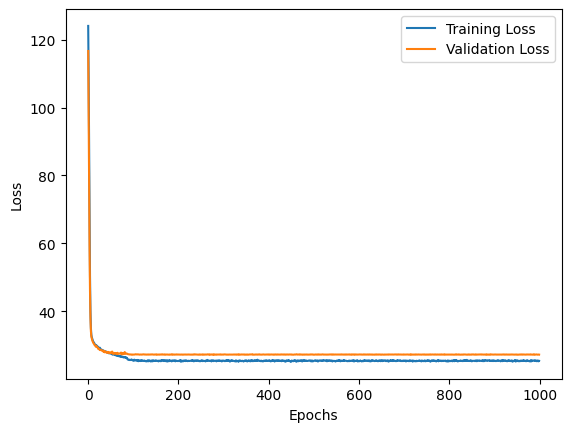

In [23]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from torch.optim import lr_scheduler
import torch.nn.functional as F
import matplotlib.pyplot as plt
from scipy import stats

# Function to remove outliers based on Z-Score
def remove_outliers_zscore(data, threshold=3):
    z_scores = np.abs(stats.zscore(data))
    return data[(z_scores < threshold).all(axis=1)]

# Function to remove outliers based on IQR
def remove_outliers_iqr(data, threshold=1.5):
    q1 = np.percentile(data, 25, axis=0)
    q3 = np.percentile(data, 75, axis=0)
    iqr = q3 - q1
    lower_bound = q1 - threshold * iqr
    upper_bound = q3 + threshold * iqr
    return data[(data >= lower_bound) & (data <= upper_bound)].all(axis=1)

from scipy.stats import zscore

def prepare_dataset(mwi_datas, method='zscore', outlier_threshold=3):
    features = []
    targets = []
    
    for position, data in mwi_datas.items():
        # Feature extraction (WiFi, magnetic, iBeacon, accelerometer, gyro, AHRS)
        wifi_data = data['wifi']
        magnetic_data = data['magnetic']
        ibeacon_data = data['ibeacon']
        acce_data = data['acce']
        gyro_data = data['gyro']
        ahrs_data = data['ahrs']

        # Extract useful features
        wifi_rssi_features = [np.mean(wifi_data[:, 3].astype(float)) if wifi_data.size > 0 else 0]
        magnetic_features = [np.mean(magnetic_data[:, 1:4].astype(float)) if magnetic_data.size > 0 else 0]
        ibeacon_rssi_features = [np.mean(ibeacon_data[:, 2].astype(float)) if ibeacon_data.size > 0 else 0]
        acce_features = [np.mean(acce_data[:, 1:4].astype(float)), np.std(acce_data[:, 1:4].astype(float))] if acce_data.size > 0 else [0, 0]
        gyro_features = [np.mean(gyro_data[:, 1:4].astype(float)), np.std(gyro_data[:, 1:4].astype(float))] if gyro_data.size > 0 else [0, 0]
        ahrs_features = [np.mean(ahrs_data[:, 1:4].astype(float)), np.std(ahrs_data[:, 1:4].astype(float))] if ahrs_data.size > 0 else [0, 0]

        # Concatenate features
        feature_vector = wifi_rssi_features+ magnetic_features + ibeacon_rssi_features + acce_features + ahrs_features + gyro_features
        features.append(feature_vector)

        # Target is the (x, y) coordinates
        targets.append(position)

    # Convert to NumPy arrays
    features = np.array(features)
    targets = np.array(targets)

    # Outlier detection and removal
    if method == 'zscore':
        z_scores = np.abs(zscore(features))  # Compute z-scores for feature matrix
        mask = (z_scores < outlier_threshold).all(axis=1)  # Keep rows where z-scores are within threshold
        features = features[mask]
        targets = targets[mask]
        print(f"Removed outliers. Remaining data points: {features.shape[0]}")

    return features, targets
67
def reset_model(input_size, hidden_size, learning_rate, weight_decay):
    model = LocalizationNN(input_size=input_size, hidden_size=hidden_size).to(device)
    criterion = nn.SmoothL1Loss() # SmoothL1Loss is used for robust regression
    optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
    return model, criterion, optimizer

# Neural Network Model
class LocalizationNN(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LocalizationNN, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.bn1 = nn.BatchNorm1d(hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.bn2 = nn.BatchNorm1d(hidden_size)
        self.fc3 = nn.Linear(hidden_size, hidden_size)
        self.bn3 = nn.BatchNorm1d(hidden_size)
        self.fc4 = nn.Linear(hidden_size, 2)
        self.dropout = nn.Dropout(p=0.3)

    def forward(self, x):
        x = F.relu(self.bn1(self.fc1(x)))
        x = self.dropout(x)
        x = F.relu(self.bn2(self.fc2(x)))
        x = self.dropout(x)
        x = F.relu(self.bn3(self.fc3(x)))
        x = self.dropout(x)
        x = self.fc4(x)
        return x

# Early Stopping Class
class EarlyStopping:
    def __init__(self, patience=10, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Load the data
features, targets = prepare_dataset(mwi_datas, method='zscore', outlier_threshold=5)

# Split into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(features, targets, test_size=0.2, random_state=123)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.4, random_state=123)

# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

# Convert data to torch tensors
X_train = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train = torch.tensor(y_train, dtype=torch.float32).to(device)
X_val = torch.tensor(X_val, dtype=torch.float32).to(device)
y_val = torch.tensor(y_val, dtype=torch.float32).to(device)
X_test = torch.tensor(X_test, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.float32).to(device)

# Create DataLoader
batch_size = 128
train_dataset = TensorDataset(X_train, y_train)
val_dataset = TensorDataset(X_val, y_val)
test_dataset = TensorDataset(X_test, y_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Model hyperparameters
input_size = X_train.shape[1]
hidden_size = 512
learning_rate = 1e-3
weight_decay = 1e-3
num_epochs = 1000

# Reset model, optimizer, and loss function
model, criterion, optimizer = reset_model(input_size, hidden_size, learning_rate, weight_decay)

# Learning rate scheduler
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=10)

# Early stopping
early_stopping = EarlyStopping(patience=100)

# Training the model with DataLoader
train_losses = []
val_losses = []
best_val_loss = float('inf')

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for batch_X, batch_y in train_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        optimizer.zero_grad()
        outputs = model(batch_X)
        loss = criterion(outputs, batch_y)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * batch_X.size(0)
    
    epoch_train_loss = running_loss / len(train_loader.dataset)
    train_losses.append(epoch_train_loss)

    # Validation step
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for batch_X_val, batch_y_val in val_loader:
            batch_X_val, batch_y_val = batch_X_val.to(device), batch_y_val.to(device)
            val_outputs = model(batch_X_val)
            loss = criterion(val_outputs, batch_y_val)
            val_loss += loss.item() * batch_X_val.size(0)
    
    epoch_val_loss = val_loss / len(val_loader.dataset)
    val_losses.append(epoch_val_loss)

    # Adjust learning rate
    scheduler.step(epoch_val_loss)

    if (epoch+1) % 10 == 0:
        print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {epoch_train_loss:.4f}, Val Loss: {epoch_val_loss:.4f}, LR: {scheduler.get_last_lr()[0]}")
        
    # Save the best model
    if epoch_val_loss < best_val_loss:
        best_val_loss = epoch_val_loss
        torch.save(model.state_dict(), 'best_model.pth')

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Test step with DataLoader
model.eval()
test_loss = 0.0
with torch.no_grad():
    for batch_X_test, batch_y_test in test_loader:
        batch_X_test, batch_y_test = batch_X_test.to(device), batch_y_test.to(device)
        predictions = model(batch_X_test)
        loss = criterion(predictions, batch_y_test)
        test_loss += loss.item() * batch_X_test.size(0)
    
    test_loss /= len(test_loader.dataset)
    print(f'Test L1Loss: {test_loss:.4f}')

    # Compare predictions with ground truth
    print(f'Predicted coordinates: {predictions[:5].cpu().numpy()}')
    print(f'Actual coordinates: {batch_y_test[:5].cpu().numpy()}')

# Plot train and validation loss
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

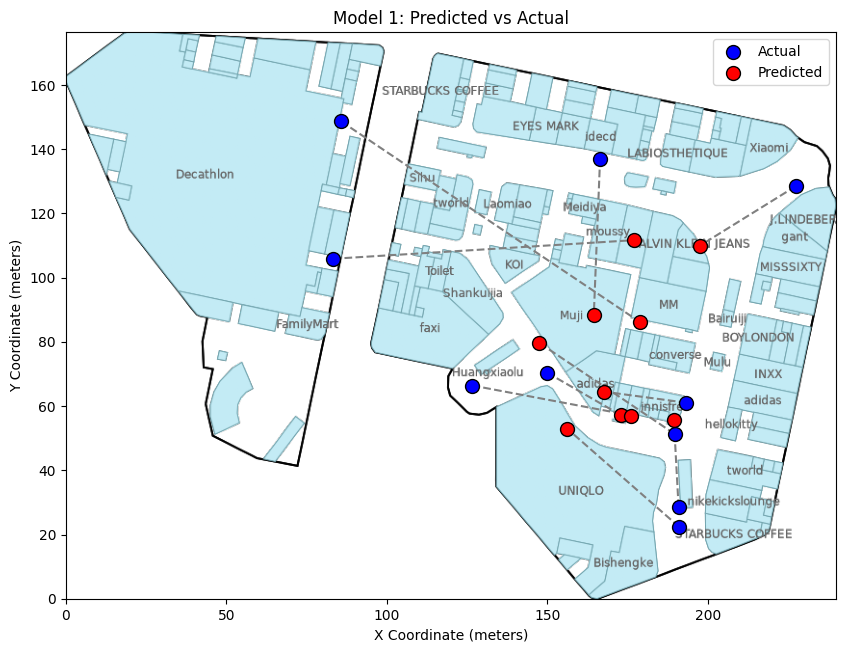

In [24]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg

def plot_predicted_vs_actual(predicted_coords, actual_coords, floor_plan_filename, width_meter, height_meter, title=None, show=False):
    # Load the floor plan image
    img = mpimg.imread(floor_plan_filename)

    # Create the figure and axis
    fig, ax = plt.subplots(figsize=(10, 10 * height_meter / width_meter))

    # Show the floor plan as the background image
    ax.imshow(img, extent=[0, width_meter, 0, height_meter])

    # Plot actual coordinates (in blue) on the floor plan
    ax.scatter(actual_coords[:, 0], actual_coords[:, 1], s=100, c='blue', label='Actual', edgecolor='black', zorder=2)
    
    # Plot predicted coordinates (in red) on the floor plan
    ax.scatter(predicted_coords[:, 0], predicted_coords[:, 1], s=100, c='red', label='Predicted', edgecolor='black', zorder=3)
    
    # Connect actual and predicted coordinates with lines
    for i in range(len(actual_coords)):
        ax.plot([actual_coords[i, 0], predicted_coords[i, 0]], [actual_coords[i, 1], predicted_coords[i, 1]], 'gray', linestyle='--', zorder=1)

    # Set axis limits
    ax.set_xlim(0, width_meter)
    ax.set_ylim(0, height_meter)

    # Set axis labels and title
    ax.set_xlabel('X Coordinate (meters)')
    ax.set_ylabel('Y Coordinate (meters)')
    if title:
        ax.set_title(title)

    # Add legend
    ax.legend()

    # Show the plot
    if show:
        plt.show()

    return fig

# # Example usage
predicted_coords = predictions[:10].cpu().numpy()
actual_coords = batch_y_test[:10].cpu().numpy()


fig = plot_predicted_vs_actual(predicted_coords, actual_coords, floor_plan_filename, width_meter, height_meter, title='Model 1: Predicted vs Actual', show=True)

In [25]:
import pandas as pd
import numpy as np

# Assuming predictions and y_test contain all the data for predicted and actual coordinates
predicted_coords = predictions.cpu().numpy()  # Convert predictions to numpy if it's still in torch tensor format
actual_coords = batch_y_test.cpu().numpy()  # Convert y_test to numpy if it's still in torch tensor format

# Calculate Euclidean distance between predicted and actual coordinates
distances = np.linalg.norm(predicted_coords - actual_coords, axis=1)

# Create a DataFrame to display the predicted, actual, and distance values
df_comparison = pd.DataFrame({
    'Predicted X': predicted_coords[:, 0],
    'Predicted Y': predicted_coords[:, 1],
    'Actual X': actual_coords[:, 0],
    'Actual Y': actual_coords[:, 1],
    'Distance': distances
})

# Sort by distance
df_comparison_sorted = df_comparison.sort_values(by='Distance')

# Display the sorted DataFrame
print(df_comparison_sorted)

# Total number of predicted and actual points
total_points = df_comparison_sorted.shape[0]
print(f'Total number of points: {total_points}')

# Count points in the specified distance ranges
count_less_than_10 = df_comparison_sorted[df_comparison_sorted['Distance'] < 10].shape[0]
count_10_to_20 = df_comparison_sorted[(df_comparison_sorted['Distance'] >= 10) & (df_comparison_sorted['Distance'] < 20)].shape[0]
count_20_to_50 = df_comparison_sorted[(df_comparison_sorted['Distance'] >= 20) & (df_comparison_sorted['Distance'] < 50)].shape[0]
count_50_to_100 = df_comparison_sorted[(df_comparison_sorted['Distance'] >= 50) & (df_comparison_sorted['Distance'] < 100)].shape[0]
count_greater_than_100 = df_comparison_sorted[df_comparison_sorted['Distance'] >= 100].shape[0]

# Compute percentages for each range
percentage_less_than_10 = (count_less_than_10 / total_points) * 100
percentage_10_to_20 = (count_10_to_20 / total_points) * 100
percentage_20_to_50 = (count_20_to_50 / total_points) * 100
percentage_50_to_100 = (count_50_to_100 / total_points) * 100
percentage_greater_than_100 = (count_greater_than_100 / total_points) * 100

# Print the count of points with their percentages in each range
print(f'Number of points with distance < 10: {count_less_than_10} ({percentage_less_than_10:.2f}%)')
print(f'Number of points with distance >= 10 and < 20: {count_10_to_20} ({percentage_10_to_20:.2f}%)')
print(f'Number of points with distance >= 20 and < 50: {count_20_to_50} ({percentage_20_to_50:.2f}%)')
print(f'Number of points with distance >= 50 and < 100: {count_50_to_100} ({percentage_50_to_100:.2f}%)')
print(f'Number of points with distance >= 100: {count_greater_than_100} ({percentage_greater_than_100:.2f}%)')

     Predicted X  Predicted Y    Actual X    Actual Y    Distance
42    136.322495   129.029831  132.875946  127.998184    3.597637
106   151.658630   130.960190  159.421570  132.706573    7.956952
74    160.193512   123.487930  154.895462  129.604294    8.091924
87    148.999069   136.550797  157.179657  135.659958    8.228950
62    167.535477   130.370087  160.242310  135.271637    8.787234
..           ...          ...         ...         ...         ...
48    204.909622   122.739037  186.989792    9.376907  114.769737
80    138.401947   113.118233  197.111832   12.710522  116.312340
10    183.917252    84.056091   67.135933   78.982887  116.891457
96    110.203651   112.283600  231.082794   85.785378  123.749443
91    201.175659    79.120178   91.740974  141.753555  126.090805

[110 rows x 5 columns]
Total number of points: 110
Number of points with distance < 10: 6 (5.45%)
Number of points with distance >= 10 and < 20: 13 (11.82%)
Number of points with distance >= 20 and < 50: 47 

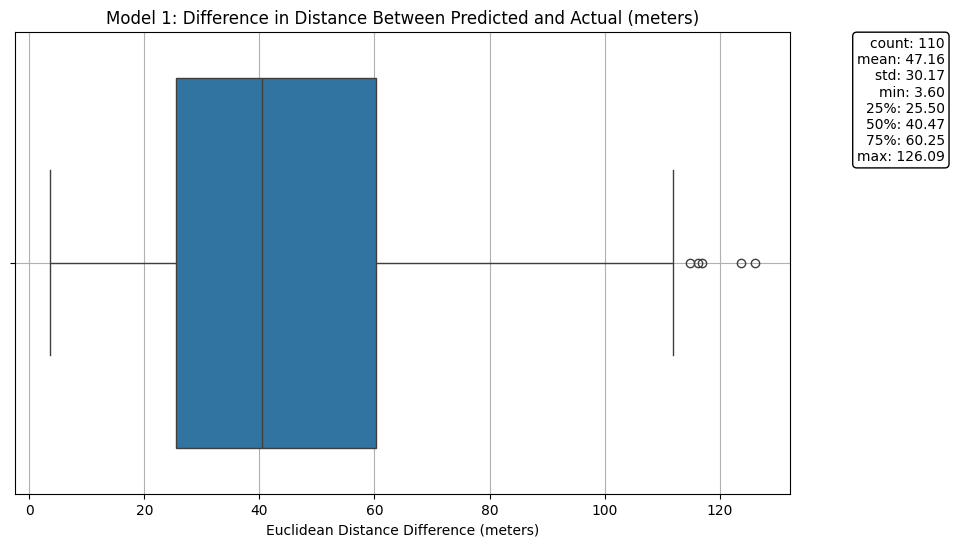

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming predictions and y_test contain all the data for predicted and actual coordinates
predicted_coords = predictions.cpu().numpy()  # Convert predictions to numpy if it's still in torch tensor format
actual_coords = batch_y_test.cpu().numpy()  # Convert y_test to numpy if it's still in torch tensor format

# Create a DataFrame with actual and predicted coordinates
score_df = pd.DataFrame({
    'actual_x': actual_coords[:, 0],
    'actual_y': actual_coords[:, 1],
    'pred_x': predicted_coords[:, 0],
    'pred_y': predicted_coords[:, 1]
})

# Calculate the Euclidean distance between predicted and actual coordinates
score_df['dist_diff'] = np.sqrt((score_df['pred_x'] - score_df['actual_x'])**2 + (score_df['pred_y'] - score_df['actual_y'])**2)

# Sort the DataFrame by distance
score_df_sorted = score_df.sort_values(by='dist_diff')

# # Display the sorted DataFrame
# print(score_df_sorted)

# Get summary statistics
summary_stats = score_df['dist_diff'].describe()

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x=score_df.dist_diff)
plt.title('Model 1: Difference in Distance Between Predicted and Actual (meters)')
plt.xlabel('Euclidean Distance Difference (meters)')
plt.grid(True)

# Adjust the position of the summary statistics inside the plot
plt.text(
    x=1.2, y=0.99,  # Adjust position within plot area in axes coordinates (closer to center)
    s=f"count: {summary_stats['count']:.0f}\n"
      f"mean: {summary_stats['mean']:.2f}\n"
      f"std: {summary_stats['std']:.2f}\n"
      f"min: {summary_stats['min']:.2f}\n"
      f"25%: {summary_stats['25%']:.2f}\n"
      f"50%: {summary_stats['50%']:.2f}\n"
      f"75%: {summary_stats['75%']:.2f}\n"
      f"max: {summary_stats['max']:.2f}",
    fontsize=10,
    verticalalignment='top',
    horizontalalignment='right',
    transform=plt.gca().transAxes,  # Use axes coordinates for text position
    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white')
)

# Save the plot as PNG
plt.savefig('distance_difference_plot.png', format='png', dpi=300, bbox_inches='tight')


# Show the plot
plt.show()

### Preparing Dataset and Building a Model 2

In [27]:
def read_file(file):
    '''
    Reads a single txt file
    '''
    acce_ls = [] # final list to append all predictors to
    waypoint_ls = [] # Initialise and remove later
    acce = []
    acce_uncali = []
    gyro = []
    gyro_uncali = []
    magn = []
    magn_uncali = []
    ahrs = []
    waypoint = []
    
    with open(file, 'r', encoding='utf-8') as file:
        lines = file.readlines()
        
    for line_data in lines:
        line_data = line_data.strip()
        if not line_data or line_data[0] == '#':
            continue
    
    for line_data in lines:
        line_data = line_data.strip()
        if not line_data or line_data[0] == '#':
            continue
    
        line_data = line_data.split('\t')
            
        if line_data[1] == 'TYPE_ACCELEROMETER':
            acce.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            
        if line_data[1] == 'TYPE_ACCELEROMETER_UNCALIBRATED':
            acce_uncali.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            continue

        if line_data[1] == 'TYPE_GYROSCOPE':
            gyro.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            continue

        if line_data[1] == 'TYPE_GYROSCOPE_UNCALIBRATED':
            gyro_uncali.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            continue

        if line_data[1] == 'TYPE_MAGNETIC_FIELD':
            magn.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            continue

        if line_data[1] == 'TYPE_MAGNETIC_FIELD_UNCALIBRATED':
            magn_uncali.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            continue

        if line_data[1] == 'TYPE_ROTATION_VECTOR':
            ahrs.append([float(line_data[2]), float(line_data[3]), float(line_data[4])])
            continue
            # continue
    
        if line_data[1] == 'TYPE_WAYPOINT':
            waypoint_ls.append((float(line_data[2]), float(line_data[3])))
            # All of these gives warning because firse key val pair does not have val. can ignore since we're removing later
            acce_avg = np.median(np.array(acce), axis = 0) 
            acce_uncali_avg = np.median(np.array(acce_uncali), axis = 0)
            gyro_avg = np.median(np.array(gyro), axis = 0)
            gyro_uncali_avg = np.median(np.array(gyro_uncali), axis = 0)
            magn_avg = np.median(np.array(magn), axis = 0)
            magn_uncali_avg = np.median(np.array(magn_uncali), axis = 0)
            ahrs_avg = np.median(np.array(ahrs), axis = 0)
            
            acce_ls.append([acce_avg, acce_uncali_avg, gyro_avg, gyro_uncali_avg, magn_avg, magn_uncali_avg, ahrs_avg])
 
            acce = []
            acce_uncali = []
            gyro = []
            gyro_uncali = []
            magn = []
            magn_uncali = []
            ahrs = []
            # continue
            
    del acce_ls[0], waypoint_ls[-1] # delete initialisation and last waypoint because last waypoint does not have predictors
    return waypoint_ls, acce_ls # return ground truth and predictors


In [28]:
# Loop through all files and read all .txt files
directory_path = './data/site1/F1'
file_list = []

# Walk through all folders and subfolders within 'directory_path'
for foldername, subfolders, filenames in os.walk(directory_path):
    for filename in filenames:
        if filename.endswith('.txt'):  # Check if the file is a .txt file
            # Use os.path.join and os.path.normpath to ensure compatibility
            file_path = os.path.normpath(os.path.join(foldername, filename))
            file_list.append(file_path)

y_ls = []
X_ls = []
for file_path in tqdm(file_list, desc="Reading files"):
    # file_path = os.path.join(directory_path, file_name)
    y, X = read_file(file_path)
    y_ls += y
    X_ls += X

assert len(y_ls) == len(X_ls)

del X, y

Reading files:   0%|          | 0/120 [00:00<?, ?it/s]/home/msai/suresh011/.conda/envs/RunJupyter/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/msai/suresh011/.conda/envs/RunJupyter/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
Reading files: 100%|██████████| 120/120 [00:04<00:00, 25.47it/s]


In [29]:
# Split into train, val, test set
test_size = 0.2
val_size = 0.4
random_state = 123
batch_size = 64

X_array = np.stack(X_ls)
y_array = np.array(y_ls)

X_train, X_test, y_train, y_test = train_test_split( X_array, y_array, test_size = test_size, random_state=random_state, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split( X_test, y_test, test_size = val_size, random_state=random_state, shuffle=True)

print(X_train.shape, X_test.shape, X_val.shape)

(684, 7, 3) (102, 7, 3) (69, 7, 3)


In [30]:
def get_scaler(df, scaler):
    '''
    Get scaler
    '''
    original_shape = df.shape
    X_reshaped = df.reshape(-1, original_shape[2])
    scaler = StandardScaler().fit(X_reshaped)
    X_scaled = scaler.transform(X_reshaped)
    return scaler
    
def multi_dim_scaler(df, scaler):
    '''
    Scaling > 2D arrays
    '''
    original_shape = df.shape
    X_reshaped = df.reshape(-1, original_shape[2])
    X_scaled = scaler.transform(X_reshaped)
    X_scaled_reshaped = X_scaled.reshape(original_shape)
    return X_scaled_reshaped

In [31]:
# preprocess the data via standardization
X_scaler = get_scaler(X_train, StandardScaler())

# change from 3D to 2D
X_train_scaled = multi_dim_scaler(X_train, X_scaler)
X_train_scaled = X_train_scaled.reshape(X_train_scaled.shape[0], -1)

X_test_scaled = multi_dim_scaler(X_test, X_scaler)
X_test_scaled = X_test_scaled.reshape(X_test_scaled.shape[0], -1)

X_val_scaled = multi_dim_scaler(X_val, X_scaler)
X_val_scaled = X_val_scaled.reshape(X_val_scaled.shape[0], -1)

In [32]:
# Load into dataloader
train_data = TensorDataset(torch.tensor(X_train_scaled), torch.tensor(y_train))
val_data = TensorDataset(torch.tensor(X_val_scaled), torch.tensor(y_val))
test_data = TensorDataset(torch.tensor(X_test_scaled), torch.tensor(y_test))

train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=False)
val_loader = DataLoader(val_data, batch_size=batch_size, shuffle=True)

In [33]:
for i,j in val_loader:
    print(i.shape)
    print(j.shape)
    break

torch.Size([64, 21])
torch.Size([64, 2])


In [34]:
def train(model, iterator, optimizer, criterion):
    epoch_loss = 0
    model.train()
    
    for features, target in iterator:
        features, target = features.float().to(device), target.float().to(device)
        optimizer.zero_grad()
        predictions = model(features)
        loss = criterion(predictions,target)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
    return epoch_loss / len(iterator)

def evaluate(model, iterator, criterion):
    epoch_loss = 0
    model.eval()

    with torch.no_grad():
        for features, target in iterator:
            features, target = features.float().to(device), target.float().to(device)
            predictions = model(features)
            loss = criterion(predictions,target)
            epoch_loss += loss.item()
    return epoch_loss / len(iterator)

def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [35]:
class DeeperMLP(nn.Module):
    def __init__(self, input_size, output_dim=2):
        super(DeeperMLP,self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.bn1 = nn.BatchNorm1d(64)
        self.fc2 = nn.Linear(64, 32)
        self.bn2 = nn.BatchNorm1d(32)
        self.output = nn.Linear(32, output_dim)
        self.dropout = nn.Dropout(p=0.4) 

    def forward(self, x):
        x = F.relu(self.bn1(self.fc1(x)))
        x = self.dropout(x)
        x = F.relu(self.bn2(self.fc2(x)))
        x = self.output(x)  
        return x

In [36]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model =  DeeperMLP(input_size=X_train_scaled.shape[1]).to(device)
train_iterator = train_loader
val_iterator = val_loader
optimizer = optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.L1Loss().to(device)

In [37]:
import time

n_epochs = 1000
best_valid_loss = float('inf')
best_epoch = 0

for epoch in range(n_epochs):
    start_time = time.time()
    train_loss = train(model, train_iterator, optimizer, criterion)
    valid_loss = evaluate(model, val_iterator, criterion)
    end_time = time.time()
    epoch_mins, epoch_secs = epoch_time(start_time, end_time)
    
    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
        best_epoch = epoch
        # torch.save(model.state_dict(), model_path + 'tut1_Adam_model_20.pt')
    if epoch%50 == 0: # Print once every 50 epochs
        print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
        print(f'\tTrain Loss: {train_loss:.3f}')
        print(f'\t Val. Loss: {valid_loss:.3f}')
        
print(f'Best epoch: epoch {epoch} with a validation loss of {best_valid_loss}')

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 130.357
	 Val. Loss: 120.477
Epoch: 51 | Epoch Time: 0m 0s
	Train Loss: 100.326
	 Val. Loss: 102.328
Epoch: 101 | Epoch Time: 0m 0s
	Train Loss: 42.917
	 Val. Loss: 38.781
Epoch: 151 | Epoch Time: 0m 0s
	Train Loss: 29.074
	 Val. Loss: 32.112
Epoch: 201 | Epoch Time: 0m 0s
	Train Loss: 24.860
	 Val. Loss: 25.241
Epoch: 251 | Epoch Time: 0m 0s
	Train Loss: 23.566
	 Val. Loss: 24.157
Epoch: 301 | Epoch Time: 0m 0s
	Train Loss: 23.171
	 Val. Loss: 24.069
Epoch: 351 | Epoch Time: 0m 0s
	Train Loss: 23.167
	 Val. Loss: 32.785
Epoch: 401 | Epoch Time: 0m 0s
	Train Loss: 22.942
	 Val. Loss: 29.936
Epoch: 451 | Epoch Time: 0m 0s
	Train Loss: 21.771
	 Val. Loss: 25.182
Epoch: 501 | Epoch Time: 0m 0s
	Train Loss: 22.097
	 Val. Loss: 22.943
Epoch: 551 | Epoch Time: 0m 0s
	Train Loss: 21.831
	 Val. Loss: 23.148
Epoch: 601 | Epoch Time: 0m 0s
	Train Loss: 21.635
	 Val. Loss: 29.249
Epoch: 651 | Epoch Time: 0m 0s
	Train Loss: 21.096
	 Val. Loss: 27.158
Epoc

In [38]:
mae_loss = nn.L1Loss()
model.eval()

# Initialize a variable to track the total MAE loss
total_mae = 0.0
num_samples = 0

actual_x = []
actual_y = []
pred_x = []
pred_y = []

with torch.no_grad():
    for inputs, targets in test_loader:  
        inputs = inputs.float().to(device)
        targets = targets.float().to(device)
        
        outputs = model(inputs) # prediction
        mae = mae_loss(outputs, targets)
        total_mae += mae.item() * inputs.size(0)  
        num_samples += inputs.size(0)
        
        actual_x.extend(targets[:, 0].cpu().numpy())  # Extract actual x
        actual_y.extend(targets[:, 1].cpu().numpy())  # Extract actual y
        pred_x.extend(outputs[:, 0].cpu().numpy())  # Extract predicted x
        pred_y.extend(outputs[:, 1].cpu().numpy())  # Extract predicted y

average_mae = total_mae / num_samples

print(f"Mean Absolute Error on the validation set: {average_mae:.4f}")

Mean Absolute Error on the validation set: 22.4335


In [39]:
score_df = pd.DataFrame({
    'actual_x': actual_x,
    'actual_y': actual_y,
    'pred_x': pred_x,
    'pred_y': pred_y })

# Get difference in eucleadian distance
score_df['dist_diff'] = np.sqrt((score_df['pred_x'] - score_df['actual_x'])**2 + (score_df['pred_y'] - score_df['actual_y'])**2)

In [40]:
import pandas as pd
import numpy as np

# Assuming predictions and y_test contain all the data for predicted and actual coordinates
predicted_coords = predictions.cpu().numpy()  # Convert predictions to numpy if it's still in torch tensor format
actual_coords = batch_y_test.cpu().numpy()  # Convert y_test to numpy if it's still in torch tensor format

# Calculate Euclidean distance between predicted and actual coordinates
distances = np.linalg.norm(predicted_coords - actual_coords, axis=1)

# Create a DataFrame to display the predicted, actual, and distance values
df_comparison = pd.DataFrame({
    'Predicted X': predicted_coords[:, 0],
    'Predicted Y': predicted_coords[:, 1],
    'Actual X': actual_coords[:, 0],
    'Actual Y': actual_coords[:, 1],
    'Distance': distances
})

# Sort by distance
df_comparison_sorted = df_comparison.sort_values(by='Distance')

# Display the sorted DataFrame
print(df_comparison_sorted)

# Total number of predicted and actual points
total_points = df_comparison_sorted.shape[0]
print(f'Total number of points: {total_points}')

# Count points in the specified distance ranges
count_less_than_10 = df_comparison_sorted[df_comparison_sorted['Distance'] < 10].shape[0]
count_10_to_20 = df_comparison_sorted[(df_comparison_sorted['Distance'] >= 10) & (df_comparison_sorted['Distance'] < 20)].shape[0]
count_20_to_50 = df_comparison_sorted[(df_comparison_sorted['Distance'] >= 20) & (df_comparison_sorted['Distance'] < 50)].shape[0]
count_50_to_100 = df_comparison_sorted[(df_comparison_sorted['Distance'] >= 50) & (df_comparison_sorted['Distance'] < 100)].shape[0]
count_greater_than_100 = df_comparison_sorted[df_comparison_sorted['Distance'] >= 100].shape[0]

# Compute percentages for each range
percentage_less_than_10 = (count_less_than_10 / total_points) * 100
percentage_10_to_20 = (count_10_to_20 / total_points) * 100
percentage_20_to_50 = (count_20_to_50 / total_points) * 100
percentage_50_to_100 = (count_50_to_100 / total_points) * 100
percentage_greater_than_100 = (count_greater_than_100 / total_points) * 100

# Print the count of points with their percentages in each range
print(f'Number of points with distance < 10: {count_less_than_10} ({percentage_less_than_10:.2f}%)')
print(f'Number of points with distance >= 10 and < 20: {count_10_to_20} ({percentage_10_to_20:.2f}%)')
print(f'Number of points with distance >= 20 and < 50: {count_20_to_50} ({percentage_20_to_50:.2f}%)')
print(f'Number of points with distance >= 50 and < 100: {count_50_to_100} ({percentage_50_to_100:.2f}%)')
print(f'Number of points with distance >= 100: {count_greater_than_100} ({percentage_greater_than_100:.2f}%)')

     Predicted X  Predicted Y    Actual X    Actual Y    Distance
42    136.322495   129.029831  132.875946  127.998184    3.597637
106   151.658630   130.960190  159.421570  132.706573    7.956952
74    160.193512   123.487930  154.895462  129.604294    8.091924
87    148.999069   136.550797  157.179657  135.659958    8.228950
62    167.535477   130.370087  160.242310  135.271637    8.787234
..           ...          ...         ...         ...         ...
48    204.909622   122.739037  186.989792    9.376907  114.769737
80    138.401947   113.118233  197.111832   12.710522  116.312340
10    183.917252    84.056091   67.135933   78.982887  116.891457
96    110.203651   112.283600  231.082794   85.785378  123.749443
91    201.175659    79.120178   91.740974  141.753555  126.090805

[110 rows x 5 columns]
Total number of points: 110
Number of points with distance < 10: 6 (5.45%)
Number of points with distance >= 10 and < 20: 13 (11.82%)
Number of points with distance >= 20 and < 50: 47 

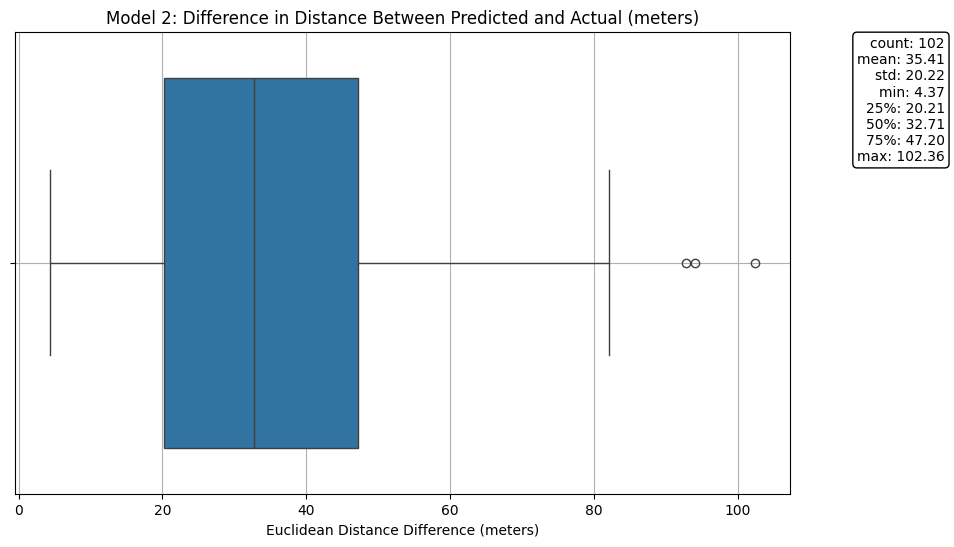

In [41]:
import matplotlib.pyplot as plt
import seaborn as sns

# Sort the DataFrame by distance
score_df_sorted = score_df.sort_values(by='dist_diff')

# # Display the sorted DataFrame
# print(score_df_sorted)

# Get summary statistics
summary_stats = score_df['dist_diff'].describe()

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x=score_df.dist_diff)
plt.title('Model 2: Difference in Distance Between Predicted and Actual (meters)')
plt.xlabel('Euclidean Distance Difference (meters)')
plt.grid(True)

# Adjust the position of the summary statistics inside the plot
plt.text(
    x=1.2, y=0.99,  # Adjust position within plot area in axes coordinates (closer to center)
    s=f"count: {summary_stats['count']:.0f}\n"
      f"mean: {summary_stats['mean']:.2f}\n"
      f"std: {summary_stats['std']:.2f}\n"
      f"min: {summary_stats['min']:.2f}\n"
      f"25%: {summary_stats['25%']:.2f}\n"
      f"50%: {summary_stats['50%']:.2f}\n"
      f"75%: {summary_stats['75%']:.2f}\n"
      f"max: {summary_stats['max']:.2f}",
    fontsize=10,
    verticalalignment='top',
    horizontalalignment='right',
    transform=plt.gca().transAxes,  # Use axes coordinates for text position
    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white')
)

# Save the plot as PNG
plt.savefig('distance_difference_plot.png', format='png', dpi=300, bbox_inches='tight')


# Show the plot
plt.show()

Prediction:
tensor([[ 83.1087, 127.5030],
        [174.4321, 115.7728],
        [186.7861,  54.8053],
        [170.2299, 126.4771],
        [167.6517,  53.2737]], device='cuda:0', grad_fn=<AddmmBackward0>)

Ground Truth:
tensor([[ 54.3278,  91.0697],
        [180.8774, 122.4259],
        [221.9000,  43.5506],
        [220.1017, 121.1147],
        [149.8014,  72.6711]], dtype=torch.float64)


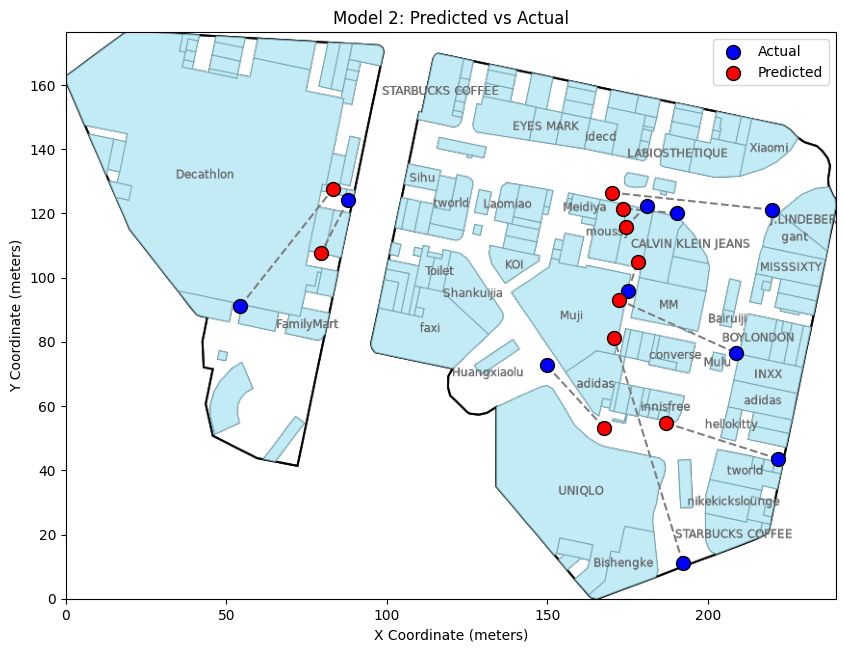

In [42]:
for features, target in test_loader:
    print('Prediction:')
    print((model(features[:5].float().to(device))))
    print('======='*10, end = '\n\n')
    print('Ground Truth:')
    print(target[:5])
    break


points = 10
predictions = model(features[:points].float().to(device)).cpu().detach().numpy()
y_test = target[:points].cpu().detach().numpy()

predicted_coords = predictions
actual_coords = y_test


fig = plot_predicted_vs_actual(predicted_coords, actual_coords, floor_plan_filename, width_meter, height_meter, title='Model 2: Predicted vs Actual', show=True)